In [4]:
import numpy as np
import matplotlib.pyplot as plt
import math
from matplotlib.patches import Circle
from matplotlib.animation import FuncAnimation
import numba

from hardDisks import dynamicHardDisks, staticHardDisks, hardDiskTrajectory

# Exercise 2: Hard disks in a square

Consider a system of $N$ identical hard disks with diameter $1$ in a
square of size $10$. The use of periodic boundary conditions can be
switched on or off. The energy of this system ($U$) is either $U=0$ 
(no overlaps) or $U=\infty$ (at least one overlap). We would like to calculate the
radial distribution function of the disks ($g\left(r\right), \,\,r <
5$) in the canonical ensemble. There are 2 methods of calculating
this:
### 1. Dynamic scheme
- **Initialize** the system by placing all disks in a **square lattice**.  
- **Move the disks** one by one in small random steps (i.e, trial moves):  
  1. Select a disk randomly and attempt to move it slightly in a random direction.  
  2. Check for overlaps:  
     - If **no overlap**, accept the move and update the position.  
     - If **overlap occurs**, reject the move, and the disk remains in place.  
- **Repeat** this process many times until the system reaches a stable state (**equilibrium**).  
- **Compute \( g(r) \)** by measuring the pairwise distances between disks and averaging over all accepted configurations.  


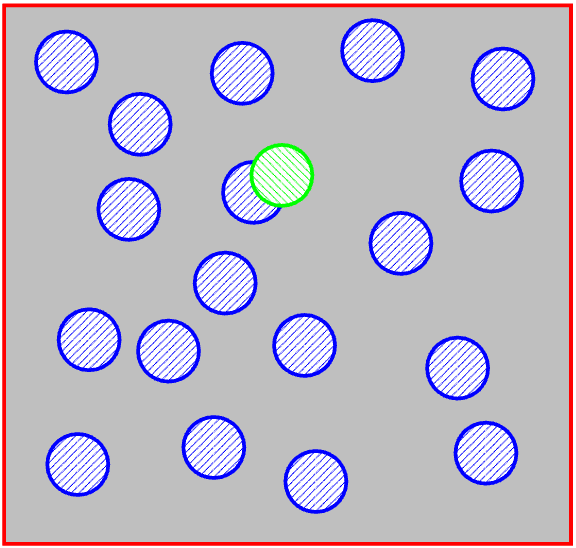

### 2. Static scheme

- Instead of moving disks step by step, we **randomly place** all disks in a new position in **each cycle**.  
- After placing all disks randomly, we check for overlaps:  
  - If **no overlap**, we calculate \( g(r) \) and count this configuration.  
  - If **there is an overlap**, we discard this configuration and do not count it.  
- This process is repeated many times, and we take an **average of the valid cases** to get \( g(r) \).  

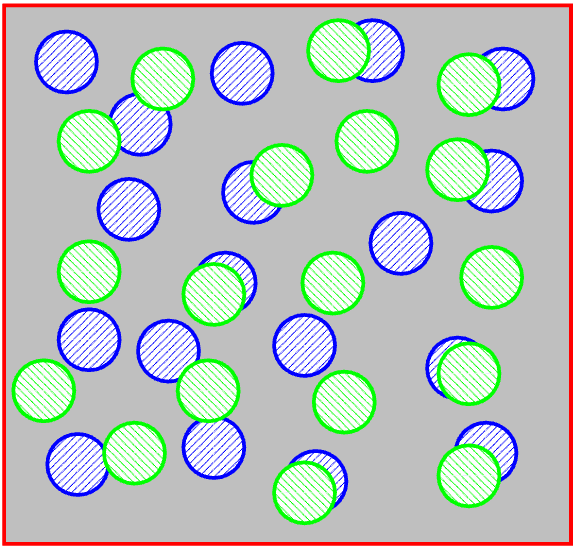


**Figures:** Eighteen hard disks in a box. The blue particles constitute the old system,
 the green particles the new system. The dynamic scheme performs a displacement trial move
 in one of the particles. The move is rejected when there is a overlap. The static scheme puts all
 particles at new random positions in the system. The move is accepted when there is no overlap.

## Periodic boundary conditions
From the lecture, you already had a look at periodic boundary conditions. 
Periodic boundary conditions (PBCs) mimic an infinite system by tiling the simulation box with 
identical copies of itself. In a L by L box, particles leaving one side re-enter from the opposite 
side, ensuring continuity. Interactions are calculated using the minimum image convention, where 
each particle interacts with the closest image of other particles, considering the periodic replicas. 
This eliminates edge effects, making the finite system behave like an infinite one.

### Question 1:
Look at the code in ```molsim.hardDisks.py``` in the Python code where the dynamic (```dynamicHardDisks```) Monte Carlo scheme is implemented. 
Your task is to complete the functions ```checkOverlapParticles```, ```checkOverlapWalls``` and ```lowerTriangularDistMatrix``` for both cases: 
with and without periodic boundary conditions (PBC).

For hard disks:
- ***With PBC***: A particle can move outside the simulation box. This movement is treated as though it enters from 
the opposite side, effectively wrapping around the box. You must ensure that the particle does not overlap 
with any other particles or their periodic images after the move.
- ***Without PBC***: Particles are confined within the box. A move is only valid if the particle stays entirely 
within the box boundaries and does not overlap with any other particle.

First we will work on completing the ```checkOverlapParticles``` and ```checkOverlapWalls``` functions. If implemented correctly the visualization bellow 
should show no overlap and depending on wether PBC are applied stay within or move beyond the box. The disk diameter 
is 1 $\sigma$ and box size is in units of $\sigma$.
You can modify the $\texttt{boxSize}$ or $\texttt{numberOfParticles}$ to visualy see how the density changes the MC moves performed and acceptance in the scheme.

In the visualization, the red disk represents the particle being considered for the Monte Carlo move. If the move is rejected, the disk becomes fully red.

In [9]:
boxSize = 10.0  # in units size sigma
periodicBoundary = True

# Run the simulation
_, positionsDynamicPbcTrue, _, acceptedMoveDynamicPbcTrue = dynamicHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(100),
    numberOfParticles=32,
    maxDisplacement=0.5,
    sampleFrequency=1,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

# Plot the trajectory
hardDiskTrajectory(
    positionsDynamicPbcTrue, acceptedMoveDynamicPbcTrue, boxSize, periodicBoundary=periodicBoundary, dynamic=True
)

The acceptance fraction: 0.9673952604739526


In [10]:
periodicBoundary = False

# Run the simulation
_, positionsDynamicPbcFalse, _, acceptedMoveDynamicPbcFalse = dynamicHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(100),
    numberOfParticles=32,
    maxDisplacement=0.5,
    sampleFrequency=1,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

# Plot the trajectory
hardDiskTrajectory(
    positionsDynamicPbcFalse, acceptedMoveDynamicPbcFalse, boxSize, periodicBoundary=periodicBoundary, dynamic=True
)

The acceptance fraction: 0.9507639236076393


<div style="max-width: 1000px; margin-left: 0; margin-right: auto; font-size: 20px; line-height: 1.6;">

## Question 2:
With the implemented `checkOverlapParticles` and `checkOverlapWalls` functions, the static scheme implemented in `staticHardDisks` is now also functional. 
Compare the animations above with those shown below. What differences do you observe in the acceptance rates? Can both methods operate effectively at the 
same density? How much does the system change over the 100 Monte Carlo steps displayed below?

</div>

In [7]:
boxSize = 10.0
periodicBoundary = True

# Run the simulation
_, positionsStaticPbcTrue, _ = staticHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(100),
    numberOfParticles=16,
    maxDisplacement=0.5,
    sampleFrequency=1,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

# Plot the trajectory
hardDiskTrajectory(positionsStaticPbcTrue, None, boxSize, periodicBoundary=periodicBoundary, dynamic=True)

The acceptance fraction: 0.022557744225577443


In [8]:
boxSize = 20.0
periodicBoundary = False

# Run the simulation
_, positionsStaticPbcFalse, _ = staticHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(100),
    numberOfParticles=16,
    maxDisplacement=0.5,
    sampleFrequency=1,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

# Plot the trajectory
hardDiskTrajectory(positionsStaticPbcFalse, None, boxSize, periodicBoundary=periodicBoundary, dynamic=False)

The acceptance fraction: 0.359011098890111


## Background for Radial Distribution Function (RDF)

In Question 3, we need to  calculating the radial distribution function $g(r)$. Before answering Question 3, please read the background part first, which may be helpful.

The **Radial Distribution Function (RDF)** describes how the particle density varies as a function of distance from a reference particle. It provides insights into the structural arrangement of atoms or molecules in a system, making it a fundamental tool in molecular simulations.

### Note for Code Implementation in the `normalizeRdf` Function  

To ensure that RDF values are meaningful and comparable across different systems, three types of normalization are applied. The complete formula is:

$$
\mathrm{normalizedRdf} = \frac{\mathrm{unnormalizedRdf}}{\mathrm{areaNorm} \times \mathrm{densityNorm} \times \mathrm{sampleCounter}}
$$

#### Area Normalization  
Each bin in RDF represents a radial shell, and the number of particles in a bin should be weighted by its area. The normalization factor is given by:

$$
\mathrm{areaNorm}(r) = \pi \left( r_{\mathrm{outer}}^2 - r_{\mathrm{inner}}^2 \right)
$$

where $r_{\mathrm{outer}}$ and $r_{\mathrm{inner}}$ are the outer and inner radii of the bin, respectively. They are stored in the `edges` variable.

#### Density Normalization  
To account for system density, the RDF is normalized by the total number of particles $N$ and the cross-sectional area $L^2$ (since this is a 2D system):

$$
\mathrm{densityNorm} = \frac{N (N - 1)}{L^2}
$$

where $L$ is the size of the simulation box.

#### Sample Normalization  
When multiple configurations are considered, the RDF must be averaged over all configurations to obtain statistically reliable results:

$$
\mathrm{sampleNorm} = \frac{1}{\mathrm{sampleCounter}}
$$

where $\mathrm{sampleCounter}$ is the total number of configurations used in the calculation.

### Q&A

#### 1. What is Bin Size in RDF?  
The **bin size** in RDF refers to the width of the radial distance intervals used to compute the distribution. This is the parameter for plotting RDF. A **smaller bin size** provides finer resolution but may introduce noise due to limited sampling, while a **larger bin size** smooths the RDF curve but may obscure fine structural details. Choosing an appropriate bin size is crucial for accurately capturing key features of the system without excessive fluctuations.

#### 2. Specifically, how orthogonalization helps compare different systems?

After area normalization, the **Radial Distribution Function (RDF)** does not depend on the bin size you choose. After density normalization, the * RDF * does not depend on the density of atomic pairs in a system. After sampling normalization, the * RDF * does not depend on the number of sampled configurations. 

#### 3. What other normalizations did we do in the exercise?

You may notice that we choose the length unit as $\sigma$. The radials of balls are 1 $\sigma$. Here $\sigma$ means the repulsion distance between two particles. For example, ** Au ** atoms have differnt repulsion distances compared with * Al * atoms. But if we choose $\sigma_{Au}$ and $\sigma_{Al}$ as the length unit respectively, The simulated results work for both systems. We wish these normalization examples can help you understand how the normalization help comparisons among different systems.


## Question 3:
Next, we will focus on calculating the radial distribution function $g(r)$. 

(1) Code implement

- Your task is to complete the `lowerTriangularDistMatrix` 
function so that it works with periodic boundary conditions. This function computes the pairwise distances between particles and 
returns a **lower triangular distance matrix**, which avoids redundant calculations.
It outputs a 1D array containing the pairwise distances in the lower triangular part of the distance matrix (excluding the diagonal). 
The length of the array is 0.5 * numberOfParticles * (numberOfParticles - 1).

- Additionally, determine and implement the appropriate normalization required for radial averaging in the `normalizeRdf` function.
Radial averaging is needed to account for the increasing area of radial shells at larger distances, ensuring the radial distribution 
function $g(r)$ reflects the true particle density without geometric bias.

(2) $g(r)$ calculation and discussion

Below, a production Monte Carlo (MC) run is performed with \( 10^7 \) MC cycles, saving every 1000th MC move. 

- Please compare the $g(r)$ derived from dynamic scheme and static scheme. 
  
  (Hint: please Ensure that both the static and dynamic schemes produce the same results when the `numberOfParticles` is small.)


- Also, compare the effect of turning periodic boundary conditions off when calculating the radial distribution function $g(r)$. This analysis will be performed only for the dynamic scheme. And please explain why $g(r)$ will approach 1 for large $r$ with periodic boundaries.
    
    (Hint: If the implementation is correct, $g(r)$ will approach 1 for larger $r$ with periodic boundaries, while it will decay when 
periodic boundaries are not used. )

The acceptance fraction: 0.9853533636363636
The acceptance fraction: 0.022678


Text(0.5, 1.0, 'Radial distribution function at a density $\\rho=$ 0.16 [$\\sigma^{-2}]$')

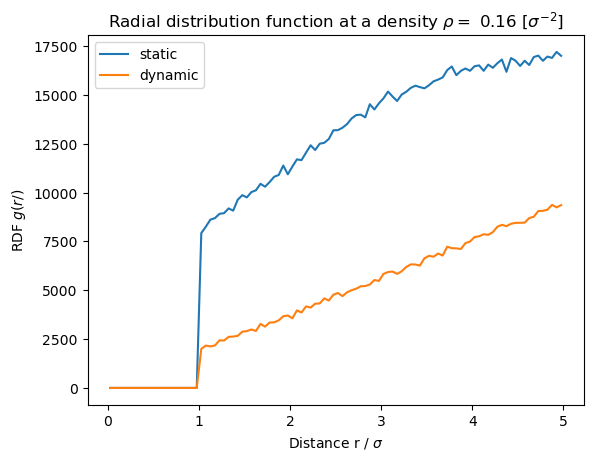

In [6]:
boxSize = 10.0
numberOfParticles = 16
periodicBoundary = True

# Run the simulation
_, _, rdfDynamicPbcTrue, _ = dynamicHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(1e7),
    numberOfParticles=numberOfParticles,
    maxDisplacement=0.5,
    sampleFrequency=1000,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

# Run the simulation
_, _, rdfStaticPbcTrue = staticHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(1e7),
    numberOfParticles=numberOfParticles,
    maxDisplacement=0.5,
    sampleFrequency=1000,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

# Plot the radial distribution function
plt.figure()
plt.plot(rdfStaticPbcTrue[0], rdfStaticPbcTrue[1], label="static")
plt.plot(rdfDynamicPbcTrue[0], rdfDynamicPbcTrue[1], label="dynamic")
plt.legend()
plt.xlabel(r"Distance r / $\sigma$")
plt.ylabel(r"RDF $g(r/)$")
plt.title(rf"Radial distribution function at a density $\rho=$ {numberOfParticles/(boxSize**2)} " + r"[$\sigma^{-2}]$")

In [ ]:
boxSize = 10.0
numberOfParticles = 16
periodicBoundary = True

# Run the simulation
_, _, rdfDynamicPbcTrue, _ = dynamicHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(1e7),
    numberOfParticles=numberOfParticles,
    maxDisplacement=0.5,
    sampleFrequency=1000,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

periodicBoundary = False

# Run the simulation
_, _, rdfDynamicPbcFalse, _ = dynamicHardDisks(
    numberOfInitCycles=int(1e6),
    numberOfProdCycles=int(1e7),
    numberOfParticles=numberOfParticles,
    maxDisplacement=0.5,
    sampleFrequency=1000,
    boxSize=boxSize,
    rdfBins=100,
    periodicBoundary=periodicBoundary,
)

In [ ]:
# Plot the radial distribution function
plt.figure()
plt.plot(rdfDynamicPbcTrue[0], rdfDynamicPbcTrue[1], label="pbc")
plt.plot(rdfDynamicPbcFalse[0], rdfDynamicPbcFalse[1], label="no pbc")
plt.legend()
plt.xlabel(r"Distance r / $\sigma$")
plt.ylabel(r"RDF $g(r/)$")
plt.title(rf"Radial distribution function at a density $\rho=$ {numberOfParticles/(boxSize**2)} " + r"[$\sigma^{-2}]$")

<div style="max-width: 1000px; margin-left: 0; margin-right: auto; font-size: 20px; line-height: 1.6;">

## Question 4:

At which density does the static method start to fail. Plot the acceptance ratio for both the methods at different densities. We will perform this analysis with periodic boundary conditions turned on. 

Based on the results you have, please compare these two methods and discuss their respective advantages. 

(Hint: you can analysis from the perspective of computational efficiency under different density conditions, e.g, acceptance ratio and the required number of steps for equilibrium)

In [ ]:
# Define parameters
numberOfParticles = 16
periodicBoundary = True
numberOfInitCycles = int(1e6)
numberOfProdCycles = int(1e6)
maxDisplacement = 0.5
sampleFrequency = 1000
rdfBins = 100

# Define box sizes to vary density
# start refactor
box_sizes = None
# end refactor

# Initialize lists to store results
acceptanceRatiosStatic = []
acceptanceRatiosDynamic = []
rdfsStatic = []
rdfsDynamic = []

# Loop over box sizes
for boxSize in box_sizes:
    # Perform dynamic Monte Carlo simulation
    print("Box size:", boxSize)

    # Perform dynamic Monte Carlo simulation
    acceptanceRatioDynamic, _, rdfDynamic, _ = dynamicHardDisks(
        numberOfInitCycles=numberOfInitCycles,
        numberOfProdCycles=numberOfProdCycles,
        numberOfParticles=numberOfParticles,
        maxDisplacement=maxDisplacement,
        sampleFrequency=sampleFrequency,
        boxSize=boxSize,
        rdfBins=rdfBins,
        periodicBoundary=periodicBoundary,
    )

    # Perform static Monte Carlo simulation
    acceptanceRatioStatic, _, rdfStatic = staticHardDisks(
        numberOfInitCycles=numberOfInitCycles,
        numberOfProdCycles=numberOfProdCycles,
        numberOfParticles=numberOfParticles,
        maxDisplacement=maxDisplacement,
        sampleFrequency=sampleFrequency,
        boxSize=boxSize,
        rdfBins=rdfBins,
        periodicBoundary=periodicBoundary,
    )

    # Store acceptance ratios
    acceptanceRatiosDynamic.append(acceptanceRatioDynamic)
    acceptanceRatiosStatic.append(acceptanceRatioStatic)

    # Store RDFs
    rdfsDynamic.append(rdfDynamic)
    rdfsStatic.append(rdfStatic)

In [ ]:
# Plot acceptance ratios
plt.figure(figsize=(8, 6))
density = numberOfParticles / np.square(box_sizes)
plt.plot(density, acceptanceRatiosStatic, label="Static MC", marker="o")
plt.plot(density, acceptanceRatiosDynamic, label="Dynamic MC", marker="o")
plt.xlabel("Density")
plt.ylabel("Acceptance Ratio")
plt.title("Acceptance Ratio vs density")
plt.legend()
plt.grid()
plt.show()

# Plot RDFs for different box sizes
# Determine number of rows and columns for subplots
num_plots = len(box_sizes)
cols = min([3, num_plots])  # Maximum of 3 columns for better readability
rows = math.ceil(num_plots / cols)

# Create subplots with a flexible grid layout
fig, ax = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
ax = ax.flatten()
fig.suptitle("Radial Distribution Function (RDF) for different densities", fontsize=16, y=1.02)

for i, boxSize in enumerate(box_sizes):
    ax[i].plot(rdfsStatic[i][0], rdfsStatic[i][1], label="Static MC RDF")
    ax[i].plot(rdfsDynamic[i][0], rdfsDynamic[i][1], label="Dynamic MC RDF")
    ax[i].set_xlabel(r"r/$\sigma$")
    ax[i].set_ylabel(r"$g(r/\sigma)$")
    ax[i].set_title(rf"$\rho = {np.round(density[i], 2)} \, [\sigma^{-2}]$")
    ax[i].set_ylim([0, np.max(rdfsDynamic[i][1]) * 1.3])
    ax[i].legend()
    ax[i].grid()
# Hide unused subplots if any
for j in range(i + 1, len(ax)):
    fig.delaxes(ax[j])
fig.tight_layout()